### Get lagged data

According to the *Interim Estimates of Vaccine Effectiveness of BNT162b2 and mRNA-1273 COVID-19 Vaccines in Preventing SARS-CoV-2 Infection Among Health Care Personnel, First Responders, and Other Essential and Frontline Workers — Eight U.S. Locations, December 2020–March 2021* published by CDC, the effectiveness of vaccines has around 14 days lag. Thus, we will add two column **vaccine lag-7** and **vaccine lag-14** for our analysis.

In [1]:
import pandas as pd
from sklearn.preprocessing import RobustScaler
from sklearn.model_selection import train_test_split
from sklearn.metrics import r2_score
import statsmodels.api as sm
from sklearn import svm
from sklearn.ensemble import RandomForestRegressor
from sklearn.datasets import make_regression
from sklearn.model_selection import RandomizedSearchCV
from sklearn.svm import SVR
from sklearn.pipeline import make_pipeline
from sklearn.preprocessing import StandardScaler
import shap
import numpy as np
from sklearn.decomposition import PCA
from sklearn.linear_model import LinearRegression
from sklearn import tree
from sklearn.model_selection import GridSearchCV
import seaborn as sn

In [2]:
data = pd.read_csv("data.csv")

In [3]:
data.columns

Index(['Unnamed: 0', 'state', 'date',
       'retail_and_recreation_percent_change_from_baseline',
       'grocery_and_pharmacy_percent_change_from_baseline',
       'parks_percent_change_from_baseline',
       'transit_stations_percent_change_from_baseline',
       'workplaces_percent_change_from_baseline',
       'residential_percent_change_from_baseline', 'stay_at_home',
       'mask_mandate', 'business_open', 'people_fully_vaccinated_per_hundred',
       'daily_vaccinations_per_million', 'submission_date', 'state_abbr',
       'new_case', 'new_case_ma7', 'new_death', 'new_death_ma7',
       'population_density', 'new_death_growth_rate', 'new_case_growth_rate'],
      dtype='object')

In [4]:
min(data["date"])

'2021-01-01'

In [5]:
max(data["date"])

'2021-04-20'

In [6]:
new_data = pd.DataFrame()
for state in data["state"].unique():
    s = data[data["state"] == state]
    s["people_fully_vaccinated_per_hundred_lag7"] = s["people_fully_vaccinated_per_hundred"].shift(7)
    s["people_fully_vaccinated_per_hundred_lag14"] = s["people_fully_vaccinated_per_hundred"].shift(14)
    s["daily_vaccinations_per_million_lag7"] = s["daily_vaccinations_per_million"].shift(7)
    s["daily_vaccinations_per_million_lag14"] = s["daily_vaccinations_per_million"].shift(14)
    new_data = new_data.append(s)


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/

In [7]:
new_data = new_data.replace("no value", None)

In [8]:
new_data["retail_and_recreation_percent_change_from_baseline"] = new_data["retail_and_recreation_percent_change_from_baseline"] / 100
new_data["grocery_and_pharmacy_percent_change_from_baseline"] = new_data["grocery_and_pharmacy_percent_change_from_baseline"] / 100
new_data["parks_percent_change_from_baseline"] = new_data["parks_percent_change_from_baseline"].astype(float) / 100
new_data["transit_stations_percent_change_from_baseline"] = new_data["transit_stations_percent_change_from_baseline"] / 100
new_data["workplaces_percent_change_from_baseline"] = new_data["workplaces_percent_change_from_baseline"] / 100
new_data["residential_percent_change_from_baseline"] = new_data["residential_percent_change_from_baseline"] / 100

In [9]:
new_data = new_data[pd.to_datetime(new_data["date"]) > pd.to_datetime("01/01/2021")]

In [10]:
new_data.describe()

,Unnamed: 0,retail_and_recreation_percent_change_from_baseline,grocery_and_pharmacy_percent_change_from_baseline,parks_percent_change_from_baseline,transit_stations_percent_change_from_baseline,workplaces_percent_change_from_baseline,residential_percent_change_from_baseline,stay_at_home,mask_mandate,business_open,...,new_case_ma7,new_death,new_death_ma7,population_density,new_death_growth_rate,new_case_growth_rate,people_fully_vaccinated_per_hundred_lag7,people_fully_vaccinated_per_hundred_lag14,daily_vaccinations_per_million_lag7,daily_vaccinations_per_million_lag14
count,5559.000000,5559.000000,5559.000000,5559.000000,5559.000000,5559.000000,5559.000000,5559.000000,5559.000000,5559.000000,...,5559.000000,5559.000000,5559.000000,5559.000000,5559.000000,5559.000000,4339.000000,3989.000000,4550.000000,4200.000000
mean,2805.000000,-0.156008,-0.068550,0.050149,-0.243828,-0.251599,0.083562,0.019608,0.693110,0.348804,...,2028.817336,35.411405,36.674607,86.043562,inf,-0.007675,9.164796,8.043144,5944.702857,5674.056429
std,1619.607526,0.133389,0.094471,0.381044,0.197465,0.114062,0.046567,0.138661,0.461245,0.496963,...,3545.809978,69.118568,62.011642,331.939366,NaN,0.071816,7.033739,6.104959,2500.782601,2314.736772
min,1.000000,-0.790000,-0.660000,-0.760000,-0.840000,-0.860000,-0.040000,0.000000,0.000000,0.000000,...,38.571429,-174.000000,-18.000000,0.081129,-4.571429,-0.559012,0.000000,0.000000,0.000000,0.000000
25%,1402.500000,-0.230000,-0.120000,-0.210000,-0.390000,-0.320000,0.050000,0.000000,0.000000,0.000000,...,327.500000,2.000000,5.000000,8.705079,-0.057692,-0.038969,2.655000,2.380000,3940.000000,3806.000000
50%,2805.000000,-0.150000,-0.070000,-0.040000,-0.240000,-0.250000,0.080000,0.000000,1.000000,0.000000,...,919.000000,11.000000,15.142857,20.849967,0.000000,-0.010080,8.100000,7.070000,5816.000000,5523.000000
75%,4207.500000,-0.070000,-0.010000,0.220000,-0.110000,-0.170000,0.110000,0.000000,1.000000,1.000000,...,2420.928571,39.000000,41.428571,49.720279,0.032258,0.018295,14.425000,12.800000,7631.500000,7318.250000
max,5609.000000,0.200000,0.330000,2.570000,0.440000,0.000000,0.360000,1.000000,1.000000,2.000000,...,42687.571429,764.000000,565.285714,2410.789093,inf,0.789841,30.400000,26.260000,22525.000000,20394.000000


In [11]:
import matplotlib.pyplot as plt

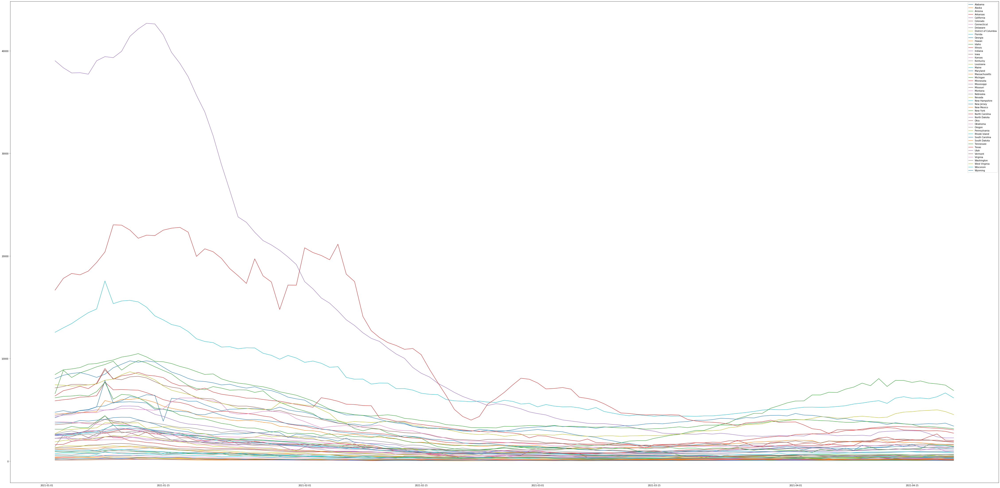

In [12]:
fig= plt.figure(figsize=(80,40))

for state in new_data["state"].unique():
    sub = new_data[new_data["state"] == state]

    x = pd.to_datetime(sub["date"])
    y = sub["new_case_ma7"]

    plt.plot(x, y, label = state)

plt.legend()

plt.show()

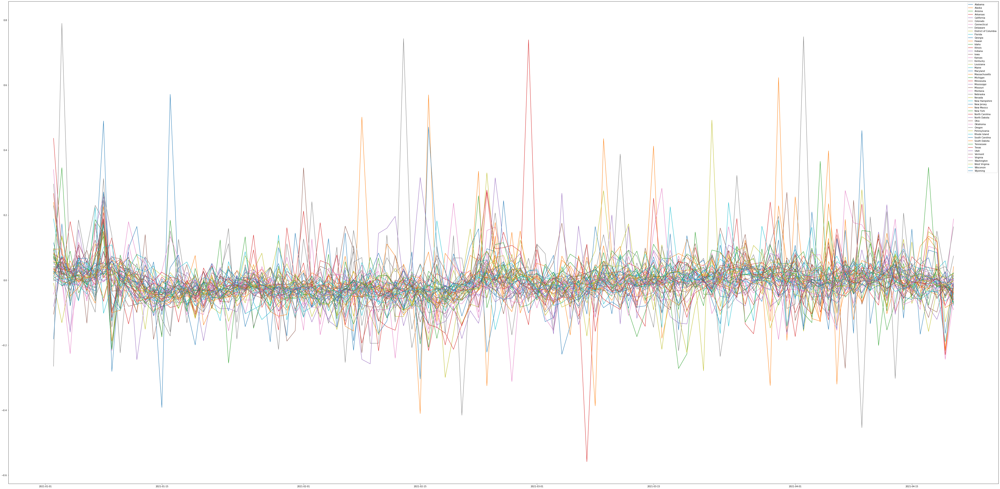

In [13]:
fig= plt.figure(figsize=(80,40))

for state in new_data["state"].unique():
    sub = new_data[new_data["state"] == state]

    x = pd.to_datetime(sub["date"])
    y = sub["new_case_growth_rate"]

    plt.plot(x, y, label = state)

plt.legend()

plt.show()

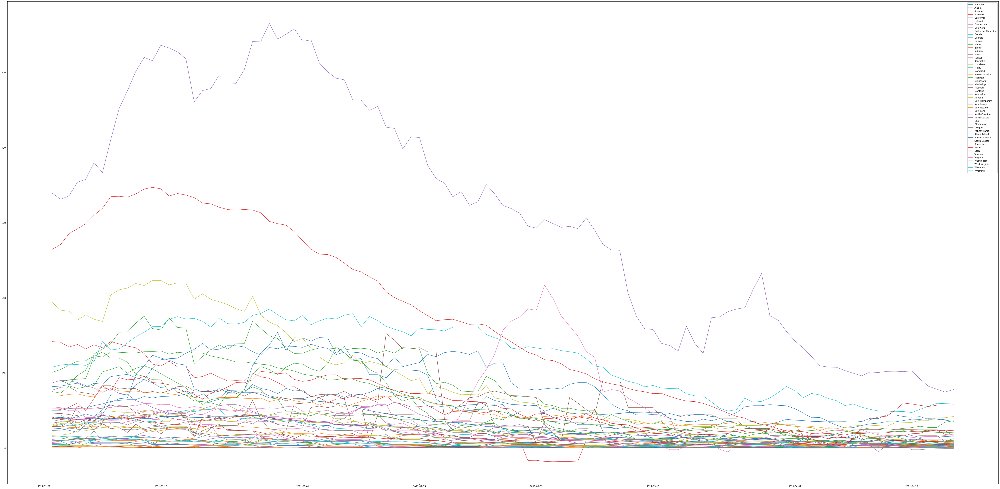

In [14]:
fig= plt.figure(figsize=(80,40))

for state in new_data["state"].unique():
    sub = new_data[new_data["state"] == state]

    x = pd.to_datetime(sub["date"])
    y = sub["new_death_ma7"]

    plt.plot(x, y, label = state)

plt.legend()

plt.show()

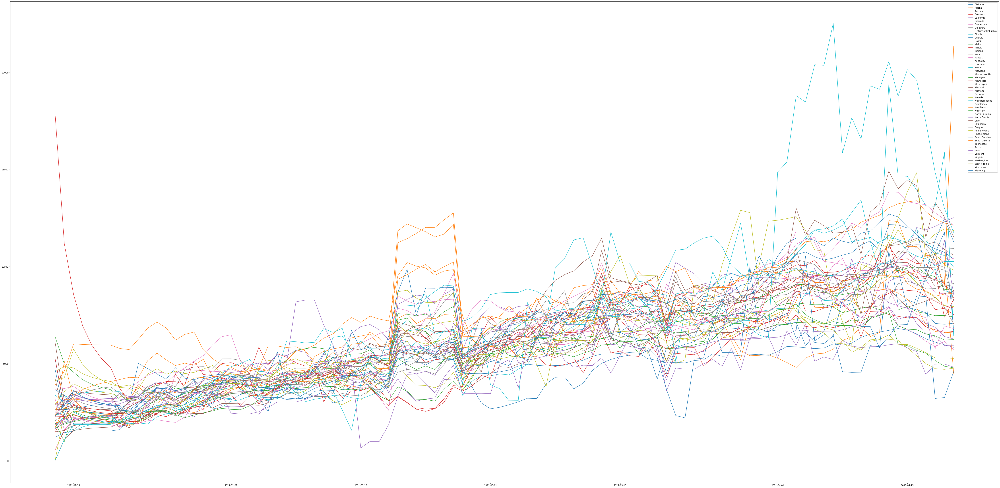

In [15]:
fig= plt.figure(figsize=(80,40))

for state in new_data["state"].unique():
    sub = new_data[new_data["state"] == state]

    x = pd.to_datetime(sub["date"])
    y = sub["daily_vaccinations_per_million"]

    plt.plot(x, y, label = state)

plt.legend()

plt.show()

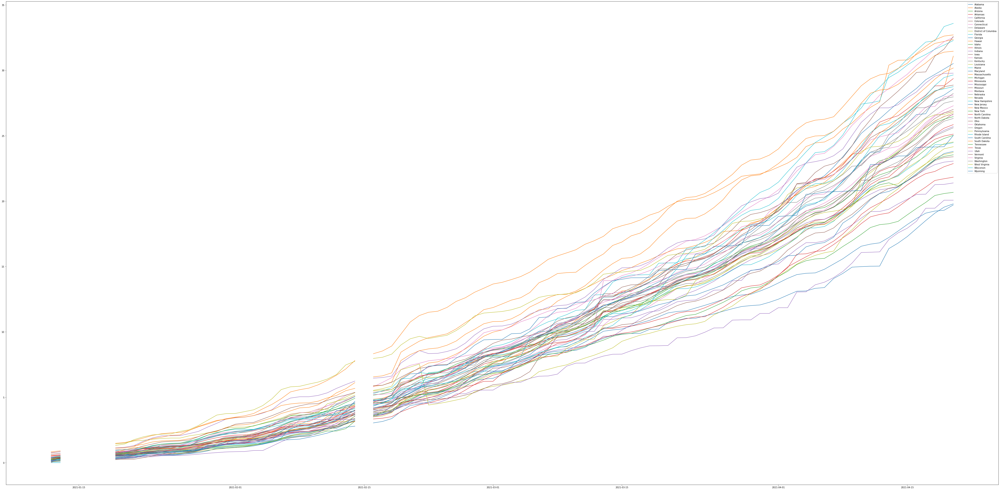

In [16]:
fig= plt.figure(figsize=(80,40))

for state in new_data["state"].unique():
    sub = new_data[new_data["state"] == state]

    x = pd.to_datetime(sub["date"])
    y = sub["people_fully_vaccinated_per_hundred"]

    plt.plot(x, y, label = state)

plt.legend()

plt.show()

In [17]:
len(new_data)

5559

In [18]:
data_without_na = new_data.dropna()

In [19]:
data_without_na.columns

Index(['Unnamed: 0', 'state', 'date',
       'retail_and_recreation_percent_change_from_baseline',
       'grocery_and_pharmacy_percent_change_from_baseline',
       'parks_percent_change_from_baseline',
       'transit_stations_percent_change_from_baseline',
       'workplaces_percent_change_from_baseline',
       'residential_percent_change_from_baseline', 'stay_at_home',
       'mask_mandate', 'business_open', 'people_fully_vaccinated_per_hundred',
       'daily_vaccinations_per_million', 'submission_date', 'state_abbr',
       'new_case', 'new_case_ma7', 'new_death', 'new_death_ma7',
       'population_density', 'new_death_growth_rate', 'new_case_growth_rate',
       'people_fully_vaccinated_per_hundred_lag7',
       'people_fully_vaccinated_per_hundred_lag14',
       'daily_vaccinations_per_million_lag7',
       'daily_vaccinations_per_million_lag14'],
      dtype='object')

### Policy and mobility

In [20]:
mob = ['retail_and_recreation_percent_change_from_baseline',
       'grocery_and_pharmacy_percent_change_from_baseline',
       'parks_percent_change_from_baseline',
       'transit_stations_percent_change_from_baseline',
       'workplaces_percent_change_from_baseline',
       'residential_percent_change_from_baseline']
pol = ['stay_at_home',
       'mask_mandate', 'business_open']

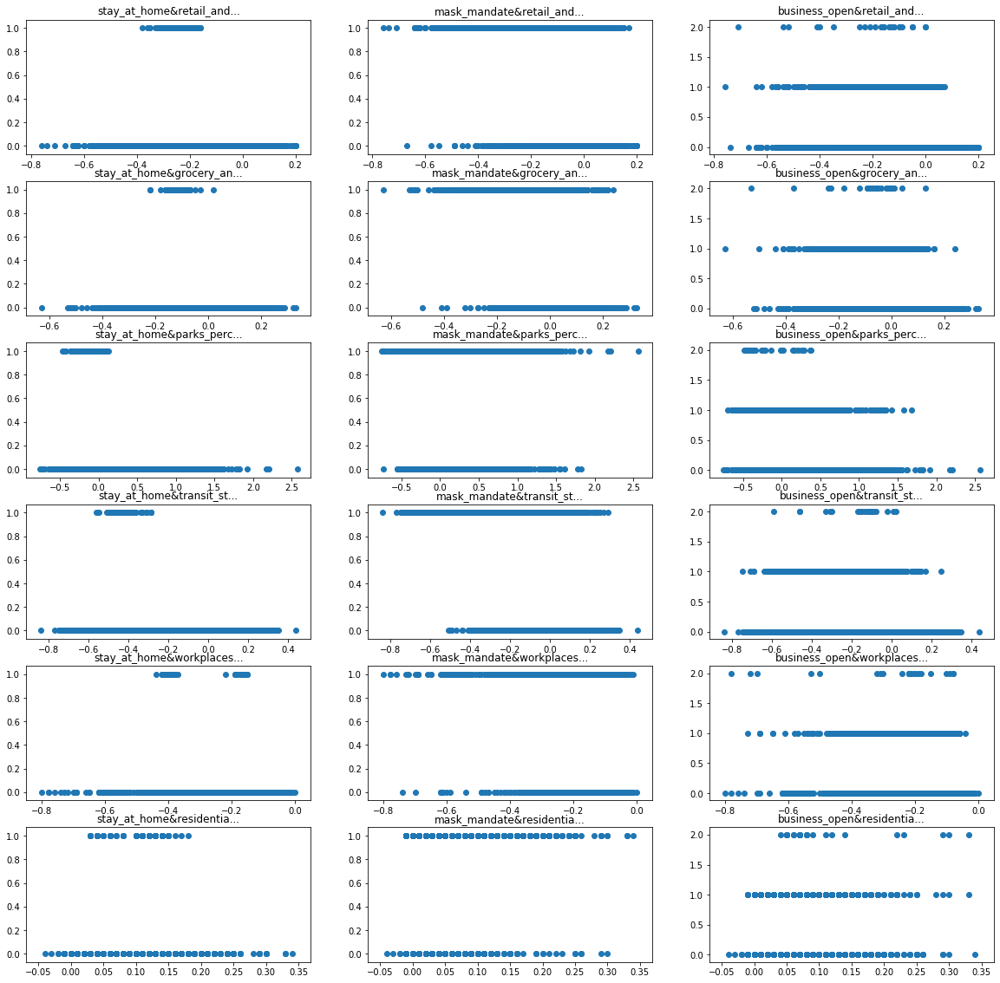

In [21]:
fig = plt.figure(figsize=(20, 20))
axs = fig.subplots(len(mob), len(pol))
for i in range(0, len(pol)):
    for j in range(0, len(mob)):
        axs[j, i].scatter(data_without_na[mob[j]], data_without_na[pol[i]])
        axs[j, i].set_title(pol[i]+"&"+mob[j][:10]+"...")

plt.show()

### Correlation matrix

In [22]:
columns = ['retail_and_recreation_percent_change_from_baseline',
       'grocery_and_pharmacy_percent_change_from_baseline',
       'parks_percent_change_from_baseline',
       'transit_stations_percent_change_from_baseline',
       'workplaces_percent_change_from_baseline',
       'residential_percent_change_from_baseline']

In [23]:
X = data_without_na[columns]

In [24]:
X.corr()

,retail_and_recreation_percent_change_from_baseline,grocery_and_pharmacy_percent_change_from_baseline,parks_percent_change_from_baseline,transit_stations_percent_change_from_baseline,workplaces_percent_change_from_baseline,residential_percent_change_from_baseline
retail_and_recreation_percent_change_from_baseline,1.000000,0.868974,0.617132,0.808386,0.524715,-0.723859
grocery_and_pharmacy_percent_change_from_baseline,0.868974,1.000000,0.596800,0.713260,0.500764,-0.681891
parks_percent_change_from_baseline,0.617132,0.596800,1.000000,0.486756,0.325315,-0.574889
transit_stations_percent_change_from_baseline,0.808386,0.713260,0.486756,1.000000,0.603781,-0.746291
workplaces_percent_change_from_baseline,0.524715,0.500764,0.325315,0.603781,1.000000,-0.858674
residential_percent_change_from_baseline,-0.723859,-0.681891,-0.574889,-0.746291,-0.858674,1.000000


In [25]:
corr = X.corr()

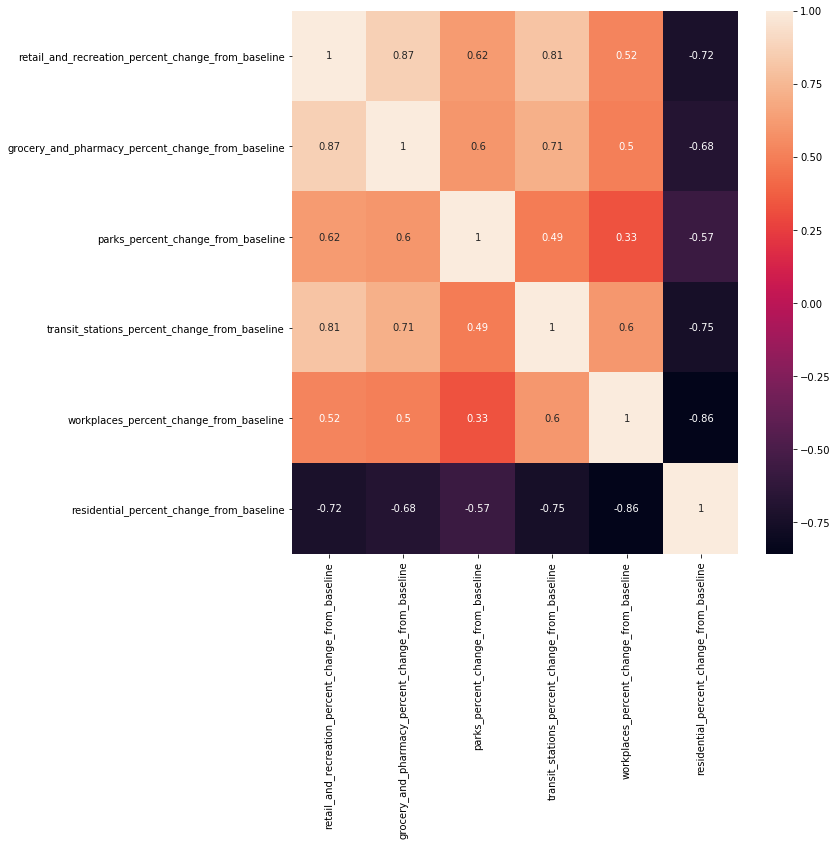

In [26]:
fig= plt.figure(figsize=(10,10))

sn.heatmap(corr, annot=True)
plt.show()

In [27]:
for i in range(corr.shape[0]):
    for j in range(i+1, corr.shape[0]):
        if abs(corr.iloc[i,j]) >= 0.85:
            print(i, j, columns[i], columns[j], corr.iloc[i,j])

0 1 retail_and_recreation_percent_change_from_baseline grocery_and_pharmacy_percent_change_from_baseline 0.8689741130830179
4 5 workplaces_percent_change_from_baseline residential_percent_change_from_baseline -0.8586742050134736


### Mobility feature selection

In [28]:
Y2 = data_without_na["new_case_growth_rate"]

In [29]:
columns = ['retail_and_recreation_percent_change_from_baseline',
       'grocery_and_pharmacy_percent_change_from_baseline',
       'parks_percent_change_from_baseline',
       'transit_stations_percent_change_from_baseline',
       'workplaces_percent_change_from_baseline',
       'residential_percent_change_from_baseline']
features = len(columns)
c = columns.copy()

In [30]:
X = data_without_na[c]
scaler = RobustScaler() 
X_scaled = scaler.fit_transform(X)

In [31]:
regressor_OLS = sm.OLS(Y2, X_scaled).fit()
for i in range(len(columns)):
    print(columns[i], regressor_OLS.pvalues[i])

retail_and_recreation_percent_change_from_baseline 1.4527351892676733e-13
grocery_and_pharmacy_percent_change_from_baseline 0.005214867385308321
parks_percent_change_from_baseline 0.999730827034334
transit_stations_percent_change_from_baseline 4.414464432237796e-13
workplaces_percent_change_from_baseline 0.02575226775330536
residential_percent_change_from_baseline 8.438097592643388e-06


In [32]:
for i in range(0, features):
    X = data_without_na[c]
    scaler = RobustScaler() 
    X_scaled = scaler.fit_transform(X)
    regressor_OLS = sm.OLS(Y2, X_scaled).fit()
    maxVar = max(regressor_OLS.pvalues)
    if maxVar > 0.05:
        for j in range(0, features - i):
            if (regressor_OLS.pvalues[j].astype(float) == maxVar):
                print(maxVar, c[j])
                c = np.delete(c, j)
    if maxVar <= 0.05:
        break
                
print(regressor_OLS.summary())
for i in range(len(c)):
    print(c[i], regressor_OLS.pvalues[i])


0.999730827034334 parks_percent_change_from_baseline
                                  OLS Regression Results                                 
Dep. Variable:     new_case_growth_rate   R-squared (uncentered):                   0.038
Model:                              OLS   Adj. R-squared (uncentered):              0.037
Method:                   Least Squares   F-statistic:                              30.23
Date:                  Mon, 26 Apr 2021   Prob (F-statistic):                    3.06e-30
Time:                          22:00:48   Log-Likelihood:                          4720.9
No. Observations:                  3845   AIC:                                     -9432.
Df Residuals:                      3840   BIC:                                     -9401.
Df Model:                             5                                                  
Covariance Type:              nonrobust                                                  
                 coef    std err          t    

In [33]:
selected_mob_column = ['retail_and_recreation_percent_change_from_baseline',
       'transit_stations_percent_change_from_baseline',
       'residential_percent_change_from_baseline']

In [34]:
new_data = pd.concat([new_data, pd.get_dummies(new_data["business_open"], prefix="business_open")], axis=1)
new_data.columns

Index(['Unnamed: 0', 'state', 'date',
       'retail_and_recreation_percent_change_from_baseline',
       'grocery_and_pharmacy_percent_change_from_baseline',
       'parks_percent_change_from_baseline',
       'transit_stations_percent_change_from_baseline',
       'workplaces_percent_change_from_baseline',
       'residential_percent_change_from_baseline', 'stay_at_home',
       'mask_mandate', 'business_open', 'people_fully_vaccinated_per_hundred',
       'daily_vaccinations_per_million', 'submission_date', 'state_abbr',
       'new_case', 'new_case_ma7', 'new_death', 'new_death_ma7',
       'population_density', 'new_death_growth_rate', 'new_case_growth_rate',
       'people_fully_vaccinated_per_hundred_lag7',
       'people_fully_vaccinated_per_hundred_lag14',
       'daily_vaccinations_per_million_lag7',
       'daily_vaccinations_per_million_lag14', 'business_open_0',
       'business_open_1', 'business_open_2'],
      dtype='object')

### Vaccine feature selection

In [35]:
columns = ['people_fully_vaccinated_per_hundred',
       'daily_vaccinations_per_million',
        'people_fully_vaccinated_per_hundred_lag7',
       'people_fully_vaccinated_per_hundred_lag14',
       'daily_vaccinations_per_million_lag7',
       'daily_vaccinations_per_million_lag14']
features = len(columns)
c = columns.copy()

In [36]:
X = data_without_na[c]
scaler = RobustScaler() 
X_scaled = scaler.fit_transform(X)

In [37]:
regressor_OLS = sm.OLS(Y2, X_scaled).fit()
for i in range(len(columns)):
    print(columns[i], regressor_OLS.pvalues[i])

people_fully_vaccinated_per_hundred 0.39659801158665187
daily_vaccinations_per_million 0.04347309199105826
people_fully_vaccinated_per_hundred_lag7 0.25038844690940326
people_fully_vaccinated_per_hundred_lag14 0.43470144566026847
daily_vaccinations_per_million_lag7 0.9965773889866352
daily_vaccinations_per_million_lag14 0.10299314713622552


In [38]:
for i in range(0, features):
    X = data_without_na[c]
    scaler = RobustScaler() 
    X_scaled = scaler.fit_transform(X)
    regressor_OLS = sm.OLS(Y2, X_scaled).fit()
    maxVar = max(regressor_OLS.pvalues)
    if maxVar > 0.05:
        for j in range(0, features - i):
            if (regressor_OLS.pvalues[j].astype(float) == maxVar):
                print(maxVar, c[j])
                c = np.delete(c, j)
    if maxVar <= 0.05:
        break
                
print(regressor_OLS.summary())
for i in range(len(c)):
    print(c[i], regressor_OLS.pvalues[i])

0.9965773889866352 daily_vaccinations_per_million_lag7
0.38636902237944126 people_fully_vaccinated_per_hundred
0.45048003084007704 people_fully_vaccinated_per_hundred_lag14
0.07416294918697962 daily_vaccinations_per_million_lag14
                                  OLS Regression Results                                 
Dep. Variable:     new_case_growth_rate   R-squared (uncentered):                   0.027
Model:                              OLS   Adj. R-squared (uncentered):              0.027
Method:                   Least Squares   F-statistic:                              53.43
Date:                  Mon, 26 Apr 2021   Prob (F-statistic):                    1.29e-23
Time:                          22:00:48   Log-Likelihood:                          4699.4
No. Observations:                  3845   AIC:                                     -9395.
Df Residuals:                      3843   BIC:                                     -9382.
Df Model:                             2           

In [39]:
from sklearn.preprocessing import PolynomialFeatures

In [40]:
poly = PolynomialFeatures(degree = 3)
c = columns.copy()

In [41]:
for v in c:
    X = data_without_na[[v]]
    scaler = RobustScaler() 
    X_scaled = scaler.fit_transform(X)
    X_poly = poly.fit_transform(X_scaled)
    regressor_OLS = sm.OLS(Y2, X_poly).fit()
    print(v)
    print(regressor_OLS.summary())

people_fully_vaccinated_per_hundred
                             OLS Regression Results                             
Dep. Variable:     new_case_growth_rate   R-squared:                       0.048
Model:                              OLS   Adj. R-squared:                  0.047
Method:                   Least Squares   F-statistic:                     64.60
Date:                  Mon, 26 Apr 2021   Prob (F-statistic):           9.55e-41
Time:                          22:00:48   Log-Likelihood:                 4759.4
No. Observations:                  3845   AIC:                            -9511.
Df Residuals:                      3841   BIC:                            -9486.
Df Model:                             3                                         
Covariance Type:              nonrobust                                         
                 coef    std err          t      P>|t|      [0.025      0.975]
---------------------------------------------------------------------------

In [42]:
select_vac_column = ["people_fully_vaccinated_per_hundred_lag7"]

## General analysis

In [43]:
scaler = RobustScaler() 

In [44]:
c = select_vac_column + selected_mob_column + pol + ["population_density"]

In [45]:
X = data_without_na[c]
X_scaled = scaler.fit_transform(X)
X_scaled_df = pd.DataFrame(X_scaled, columns = X.columns)
X_train, X_test, y_train, y_test = train_test_split(X_scaled_df, Y2, test_size=0.2, random_state=42)

In [46]:
model = LinearRegression().fit(X_train, y_train)

In [47]:
y_pred = model.predict(X_test)
r2_score(y_test, y_pred)

0.03663909603944615

In [48]:
explainer = shap.LinearExplainer(model, X_train)
shap_values = explainer.shap_values(X_test)

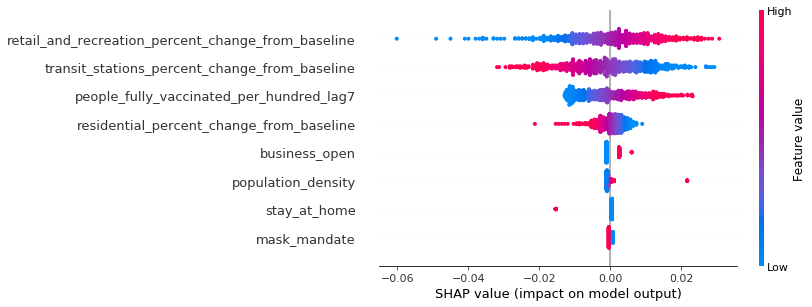

In [49]:
shap.summary_plot(shap_values, X_test)

### Desicion Tree

In [50]:
cols = c.copy()
X = data_without_na[cols]
X_train, X_test, y_train, y_test = train_test_split(X, Y2, test_size=0.2, random_state=42)

In [51]:
clf = tree.DecisionTreeRegressor(random_state=42)

In [52]:
grid = {'criterion': ["mse", "friedman_mse", "mae", "poisson"],
               'max_features': ['auto', 'sqrt'],
               'max_depth': range(2, 13),
               'min_samples_leaf': [1, 2, 4],}

In [53]:
clf_random = GridSearchCV(estimator = clf, param_grid = grid, cv = 3, n_jobs = -2)

In [54]:
clf_random.fit(X_train, y_train)

One or more of the test scores are non-finite: [ 0.02861614  0.02861614  0.02861614  0.02759354  0.02759354  0.03179085
  0.02121316  0.02109793  0.01717592  0.0266503   0.02805093  0.02717995
 -0.00184168  0.00411425  0.00324977  0.00528714  0.00831078  0.01786604
 -0.06098163 -0.03084885 -0.04447913  0.00551261  0.0034828   0.01685509
 -0.1523299  -0.08773679 -0.05419309 -0.03760896 -0.05774714 -0.00683983
 -0.56389479 -0.21833647 -0.11827088 -0.16133981 -0.11564496 -0.03368361
 -0.61601684 -0.26460695 -0.15151294 -0.11571588 -0.07314421 -0.07437841
 -0.73837709 -0.31589599 -0.18790702 -0.24935503 -0.13327571 -0.13205738
 -0.89881015 -0.41881161 -0.24062727 -0.66813655 -0.18049218 -0.1491882
 -0.96103068 -0.45517073 -0.28524004 -0.38265699 -0.27273319 -0.16934123
 -1.0240308  -0.53826018 -0.33188303 -0.58692788 -0.25531981 -0.16526174
  0.02861614  0.02861614  0.02861614  0.02759354  0.02759354  0.03179085
  0.02121316  0.02109793  0.01717592  0.0266503   0.02805093  0.02717995
 -0.0

GridSearchCV(cv=3, estimator=DecisionTreeRegressor(random_state=42), n_jobs=-2,
             param_grid={'criterion': ['mse', 'friedman_mse', 'mae', 'poisson'],
                         'max_depth': range(2, 13),
                         'max_features': ['auto', 'sqrt'],
                         'min_samples_leaf': [1, 2, 4]})

In [55]:
clf_random.best_estimator_

DecisionTreeRegressor(criterion='mae', max_depth=3, max_features='auto',
                      random_state=42)

In [56]:
best_model = clf_random.best_estimator_

In [57]:
best_model.fit(X_train, y_train)
y_pred = best_model.predict(X_test)
r2_score(y_test, y_pred)

0.030833703464695272

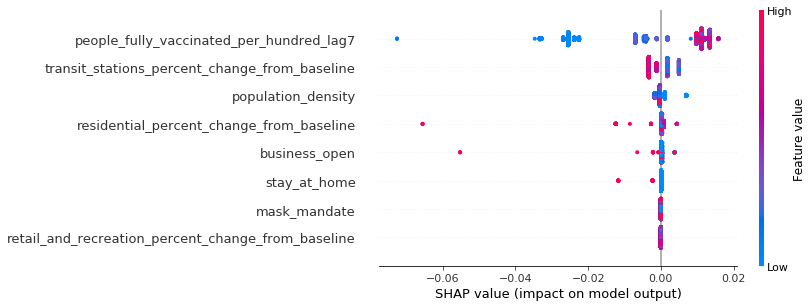

In [58]:
explainer = shap.TreeExplainer(best_model)
shap_values = explainer(X_train)
shap.plots.beeswarm(shap_values)

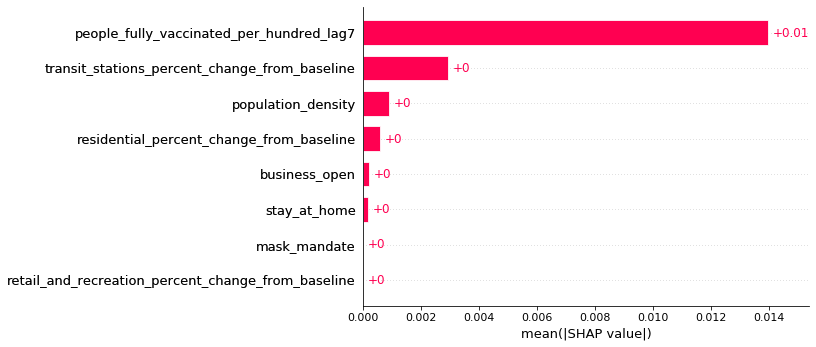

In [59]:
shap.plots.bar(shap_values)

### Random forest

In [60]:
X = data_without_na[c]
X_train, X_test, y_train, y_test = train_test_split(X, Y2, test_size=0.2, random_state=42)
rf = RandomForestRegressor()

In [61]:
grid = {'n_estimators': range(200, 2001, 200),
               'max_features': ['auto', 'sqrt'],
               'max_depth': range(2, 15, 2),
               'min_samples_leaf': [1, 2, 4],
            'bootstrap': [True, False]}

In [62]:
rf_random = RandomizedSearchCV(estimator = rf, param_distributions = grid, n_iter = 100, cv = 3, verbose=2, random_state=42, n_jobs = -2)

In [63]:
rf_random.fit(X_train, y_train)

Fitting 3 folds for each of 100 candidates, totalling 300 fits


RandomizedSearchCV(cv=3, estimator=RandomForestRegressor(), n_iter=100,
                   n_jobs=-2,
                   param_distributions={'bootstrap': [True, False],
                                        'max_depth': range(2, 15, 2),
                                        'max_features': ['auto', 'sqrt'],
                                        'min_samples_leaf': [1, 2, 4],
                                        'n_estimators': range(200, 2001, 200)},
                   random_state=42, verbose=2)

In [64]:
rf_random.best_params_

{'n_estimators': 1400,
 'min_samples_leaf': 1,
 'max_features': 'sqrt',
 'max_depth': 4,
 'bootstrap': True}

In [65]:
base_model = RandomForestRegressor(n_estimators = 10, random_state = 42)
base_model.fit(X_train, y_train)
y_pred = base_model.predict(X_test)
r2_score(y_test, y_pred)

-0.12305102322981987

In [66]:
model = rf_random.best_estimator_
model.fit(X_train, y_train)
y_pred = model.predict(X_test)
r2_score(y_test, y_pred)

0.031509719097983946

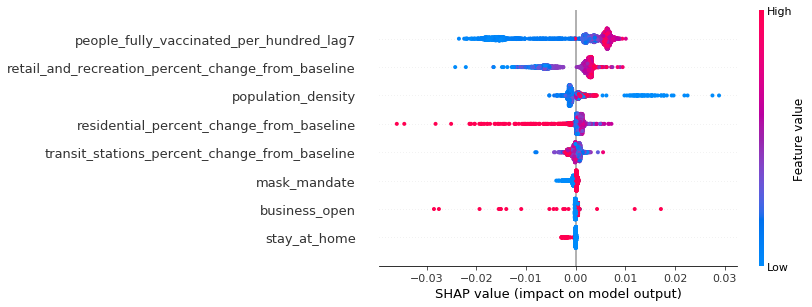

In [67]:
explainer = shap.TreeExplainer(model)
shap_values = explainer(X_train)
shap.plots.beeswarm(shap_values)

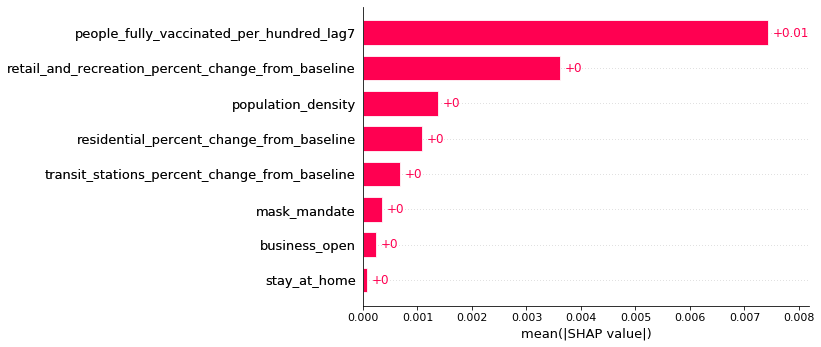

In [68]:
shap.plots.bar(shap_values)

### SVM

In [69]:
X = data_without_na[c]
X_train, X_test, y_train, y_test = train_test_split(X, Y2, test_size=0.2, random_state=42)

In [70]:
for k in ["linear", "poly", "rbf", "sigmoid"]:
    regr = make_pipeline(StandardScaler(), SVR(kernel=k, C=1.0))
    regr.fit(X_train, y_train)
    y_pred = regr.predict(X_test)
    print(k, r2_score(y_test, y_pred))

linear 0.029384193164502914
poly -0.018829020197014934
rbf -0.03232500706040664
sigmoid -366563.13179865904


In [71]:
for k in ["linear", "poly", "rbf", "sigmoid"]:
    regr = make_pipeline(RobustScaler(), SVR(kernel=k, C=1.0, epsilon=0.0001))
    regr.fit(X_train, y_train)
    y_pred = regr.predict(X_test)
    print(k, r2_score(y_test, y_pred))

linear 0.03990876250010311
poly 0.01745699544827861
rbf 0.058075878357638944
sigmoid -1394761.7813992177


In [72]:
model = SVR(kernel="poly", C=1.0, epsilon=0.0001)
scaler = RobustScaler()
X = data_without_na[c]
X_scaled = scaler.fit_transform(X)
X_scaled_df = pd.DataFrame(X_scaled, columns = X.columns)
X_train, X_test, y_train, y_test = train_test_split(X_scaled_df, Y2, test_size=0.2, random_state=42)
model.fit(X_train, y_train)
y_pred = model.predict(X_test)
print(r2_score(y_test, y_pred))

0.018352740186882155


In [73]:
explainer = shap.KernelExplainer(model.predict, X_train[:50])
shap_values = explainer.shap_values(X_test[:50], nsamples=100)

100%|██████████| 50/50 [00:21<00:00,  2.34it/s]


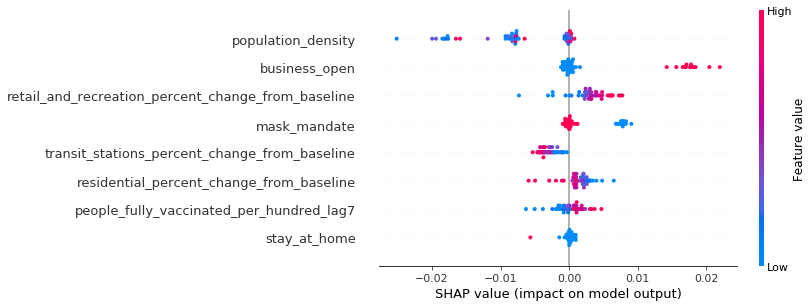

In [74]:
shap.summary_plot(shap_values, X_test[:50])

### KNN

In [75]:
from sklearn.neighbors import KNeighborsRegressor

In [76]:
X = data_without_na[c]
X_scaled = scaler.fit_transform(X)
X_scaled_df = pd.DataFrame(X_scaled, columns = X.columns)
X_train, X_test, y_train, y_test = train_test_split(X_scaled_df, Y2, test_size=0.2, random_state=42)

In [77]:
neigh = KNeighborsRegressor()

In [78]:
grid = {"n_neighbors": range(2, 30), "weights": ["uniform", "distance"]}
neigh_random = GridSearchCV(estimator = neigh, param_grid = grid, cv = 3, n_jobs = -2)

In [79]:
neigh_random.fit(X_train, y_train)

GridSearchCV(cv=3, estimator=KNeighborsRegressor(), n_jobs=-2,
             param_grid={'n_neighbors': range(2, 30),
                         'weights': ['uniform', 'distance']})

In [80]:
neigh_random.best_estimator_

KNeighborsRegressor(n_neighbors=29, weights='distance')

In [81]:
best_model = neigh_random.best_estimator_
model.fit(X_train, y_train)
y_pred = model.predict(X_test)
r2_score(y_test, y_pred)

0.018352740186882155

In [82]:
explainer = shap.KernelExplainer(best_model.predict, X_train[:100])
shap_values = explainer.shap_values(X_test[:100])

100%|██████████| 100/100 [01:03<00:00,  1.58it/s]


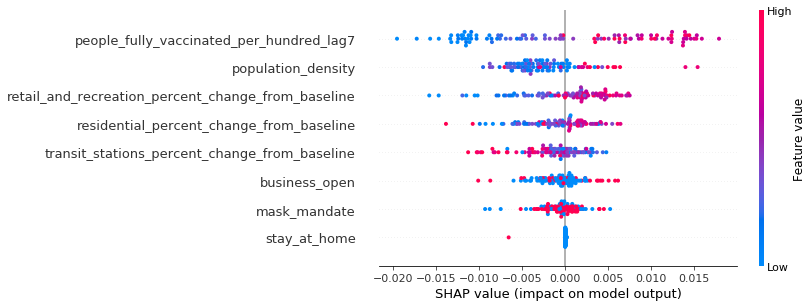

In [83]:
shap.summary_plot(shap_values, X_test[:100])

## Transform Y to categorical data

In [84]:
Y3 = Y2.copy()

In [85]:
Y3[Y3<0] = 0
Y3[Y3>0] = 1
Y3[Y3==0] = "decrease"
Y3[Y3==1] = "increase"

### Logistic regression

In [86]:
from sklearn.linear_model import LogisticRegression

In [87]:
X = data_without_na[c]
X_scaled = scaler.fit_transform(X)
X_scaled_df = pd.DataFrame(X_scaled, columns = X.columns)
X_train, X_test, y_train, y_test = train_test_split(X_scaled_df, Y3, test_size=0.2, random_state=42)

In [88]:
clf = LogisticRegression(random_state=42).fit(X_train, y_train)

In [89]:
clf.score(X_test, y_test)

0.6410923276983095

In [90]:
explainer = shap.LinearExplainer(clf, X_train)
shap_values = explainer.shap_values(X_test)

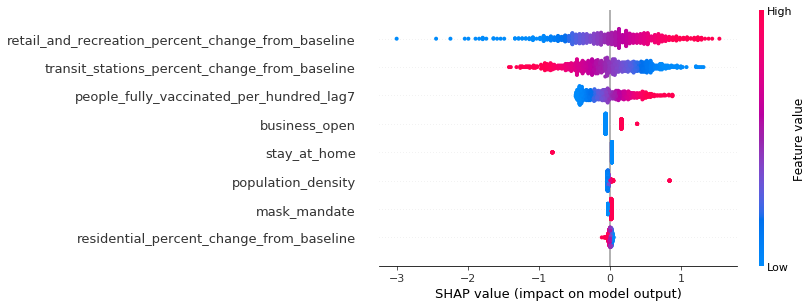

In [91]:
shap.summary_plot(shap_values, X_test)

### Decision Trees

In [92]:
from sklearn.tree import DecisionTreeClassifier

In [93]:
X = data_without_na[c]
X_train, X_test, y_train, y_test = train_test_split(X, Y3, test_size=0.2, random_state=42)

In [94]:
clf = DecisionTreeClassifier(random_state=42)

In [95]:
grid = {'max_features': ['auto', 'sqrt'],
               'max_depth': range(2, 13),
               'min_samples_leaf': [1, 2, 4],}

In [96]:
clf_random = GridSearchCV(estimator = clf, param_grid = grid, cv = 3, n_jobs = -2)
clf_random.fit(X_train, y_train)

GridSearchCV(cv=3, estimator=DecisionTreeClassifier(random_state=42), n_jobs=-2,
             param_grid={'max_depth': range(2, 13),
                         'max_features': ['auto', 'sqrt'],
                         'min_samples_leaf': [1, 2, 4]})

In [97]:
clf_random.best_estimator_

DecisionTreeClassifier(max_depth=6, max_features='auto', random_state=42)

In [98]:
best_model = clf_random.best_estimator_
best_model.fit(X_train, y_train)
best_model.score(X_test, y_test)

0.6202860858257477

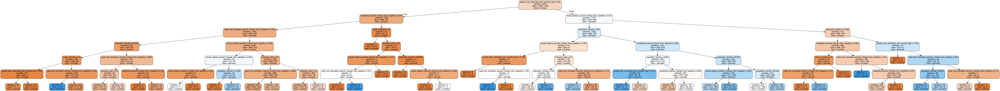

In [99]:
from IPython.display import Image  
import pydotplus
thestring = tree.export_graphviz(best_model, out_file=None,  
                         feature_names=X_train.columns.values, 
                         class_names=['increase', 'decrease'],  
                         filled=True, rounded=True,  
                         special_characters=True,impurity=False)
graph = pydotplus.graph_from_dot_data(thestring)  
Image(graph.create_png())  

In [100]:
explainer = shap.TreeExplainer(best_model)
shap_values = explainer.shap_values(X)

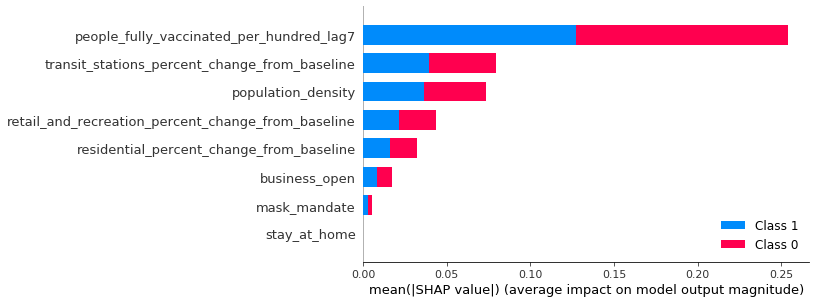

In [101]:
shap.summary_plot(shap_values, X)

### Random forest

In [102]:
from sklearn.ensemble import RandomForestClassifier

In [103]:
X = data_without_na[c]
X_train, X_test, y_train, y_test = train_test_split(X, Y3, test_size=0.2, random_state=42)
clf = RandomForestClassifier()

In [104]:
grid = {'n_estimators': range(200, 2001, 200),
               'max_features': ['auto', 'sqrt'],
               'max_depth': range(2, 15, 2),
               'min_samples_leaf': [1, 2, 4],
            'bootstrap': [True, False]}

In [105]:
clf_random = RandomizedSearchCV(estimator = clf, param_distributions = grid, n_iter = 100, cv = 3, verbose=2, random_state=42, n_jobs = -2)
clf_random.fit(X_train, y_train)

Fitting 3 folds for each of 100 candidates, totalling 300 fits
A worker stopped while some jobs were given to the executor. This can be caused by a too short worker timeout or by a memory leak.


RandomizedSearchCV(cv=3, estimator=RandomForestClassifier(), n_iter=100,
                   n_jobs=-2,
                   param_distributions={'bootstrap': [True, False],
                                        'max_depth': range(2, 15, 2),
                                        'max_features': ['auto', 'sqrt'],
                                        'min_samples_leaf': [1, 2, 4],
                                        'n_estimators': range(200, 2001, 200)},
                   random_state=42, verbose=2)

In [106]:
clf_random.best_params_

{'n_estimators': 2000,
 'min_samples_leaf': 2,
 'max_features': 'auto',
 'max_depth': 6,
 'bootstrap': True}

In [107]:
best_model = clf_random.best_estimator_
best_model.fit(X_train, y_train)
best_model.score(X_test, y_test)

0.6970091027308193

In [108]:
explainer = shap.TreeExplainer(best_model)
shap_values = explainer.shap_values(X)

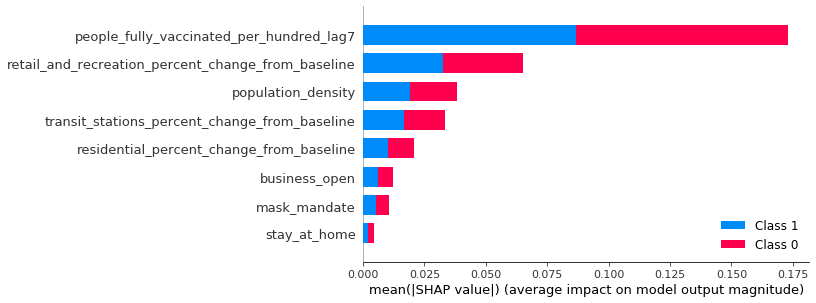

In [109]:
shap.summary_plot(shap_values, X)

### SVM

In [110]:
from sklearn.svm import SVC

In [111]:
for k in ["linear", "poly", "rbf", "sigmoid"]:
    clf = make_pipeline(RobustScaler(), SVC(kernel=k, C=1.0, probability=True))
    clf.fit(X_train, y_train)
    print(k, clf.score(X_test, y_test))

linear 0.6540962288686606
poly 0.6228868660598179
rbf 0.611183355006502
sigmoid 0.5201560468140443


In [112]:
model = SVC(kernel="rbf", C=1.0, probability=True)
scaler = RobustScaler()
X = data_without_na[c]
X_scaled = scaler.fit_transform(X)
X_scaled_df = pd.DataFrame(X_scaled, columns = X.columns)
X_train, X_test, y_train, y_test = train_test_split(X_scaled_df, Y3, test_size=0.2, random_state=42)
model.fit(X_train, y_train)
model.score(X_test, y_test)

0.6150845253576073

In [113]:
explainer = shap.KernelExplainer(model.predict_proba, X_train[:50])
shap_values = explainer.shap_values(X_test[:50], nsamples=100)

100%|██████████| 50/50 [01:03<00:00,  1.26s/it]


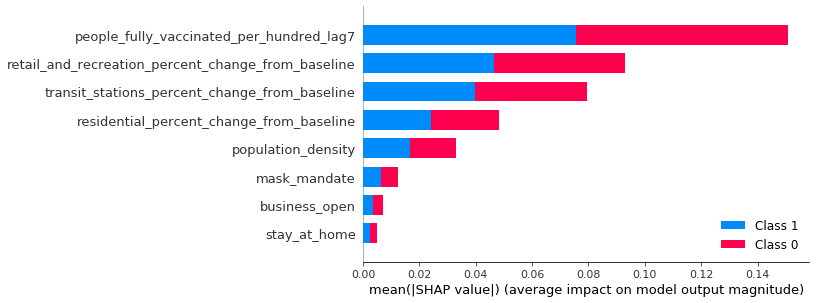

In [115]:
shap.summary_plot(shap_values, X_test[:50])

### KNN

In [116]:
from sklearn.neighbors import KNeighborsClassifier

In [117]:
X = data_without_na[c]
X_scaled = scaler.fit_transform(X)
X_scaled_df = pd.DataFrame(X_scaled, columns = X.columns)
X_train, X_test, y_train, y_test = train_test_split(X_scaled_df, Y3, test_size=0.2, random_state=42)

In [118]:
neigh = KNeighborsClassifier()

In [119]:
grid = {"n_neighbors": range(2, 30), "weights": ["uniform", "distance"]}
neigh_random = GridSearchCV(estimator = neigh, param_grid = grid, cv = 3, n_jobs = -2)
neigh_random.fit(X_train, y_train)

GridSearchCV(cv=3, estimator=KNeighborsClassifier(), n_jobs=-2,
             param_grid={'n_neighbors': range(2, 30),
                         'weights': ['uniform', 'distance']})

In [120]:
neigh_random.best_estimator_

KNeighborsClassifier(n_neighbors=16)

In [121]:
best_model = neigh_random.best_estimator_
model.fit(X_train, y_train)
best_model.score(X_test, y_test)

0.647594278283485

In [122]:
explainer = shap.KernelExplainer(best_model.predict_proba, X_train[:100])
shap_values = explainer.shap_values(X_test[:100])

100%|██████████| 100/100 [00:55<00:00,  1.80it/s]


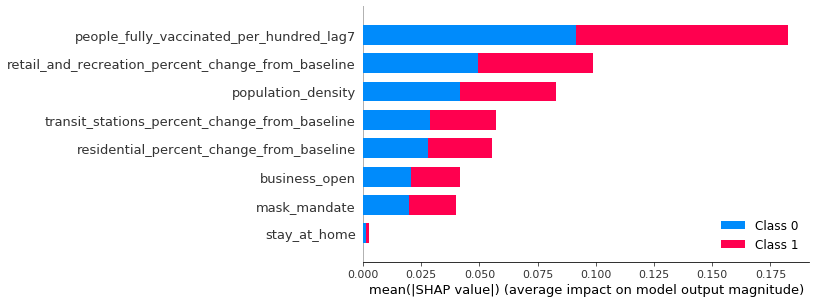

In [124]:
shap.summary_plot(shap_values, X_test[:100])

## Deep learning model